**Lossy vs Lossless (Pros and Cons of each)**

Lossy:

* Advantages: Very small file sizes and lots of tools, plugins, and software support it.

* Disadvantages: Quality degrades with higher ratio of compression. Can't get original back after compressing.

Lossless:

* Advantages: No loss of quality, slight decreases in image file sizes.

* Disadvantages: Larger files than if you were to use lossy compression.

https://www.keycdn.com/support/lossy-vs-lossless

Depends on the image we get for the coursework.

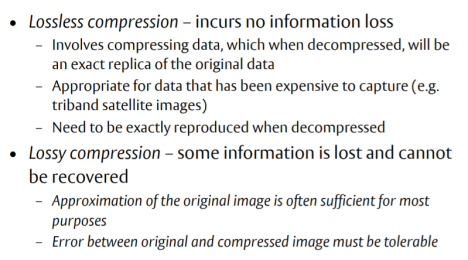

Lossy Techniques (Methods): 
- Transform coding: Data compression for "natural" data like audio signals and photographic images. When used alone, it's 100% lossless, but is normally used to enable better quantization, which leads to lossy compression.
Bandwidth is lowered due to the knowledge of the application used to choose information to discard.

- Discrete Cosine Transform (DCT): Most widely used and efficient method for lossy compression. It's a variant of Fourier-related transform. It expresses a finite sequence of data points in terms of a sum of cosine functions oscillating at different frequencies. Popularly used in JPEG images.

- Wavelet Transform (DWT)

In [1]:
pip install Pillow

In [2]:
import cv2
import math
from google.colab.patches import cv2_imshow
import numpy
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from PIL import Image
import matplotlib.cm as cm
import scipy
from numpy import *
from scipy import *

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


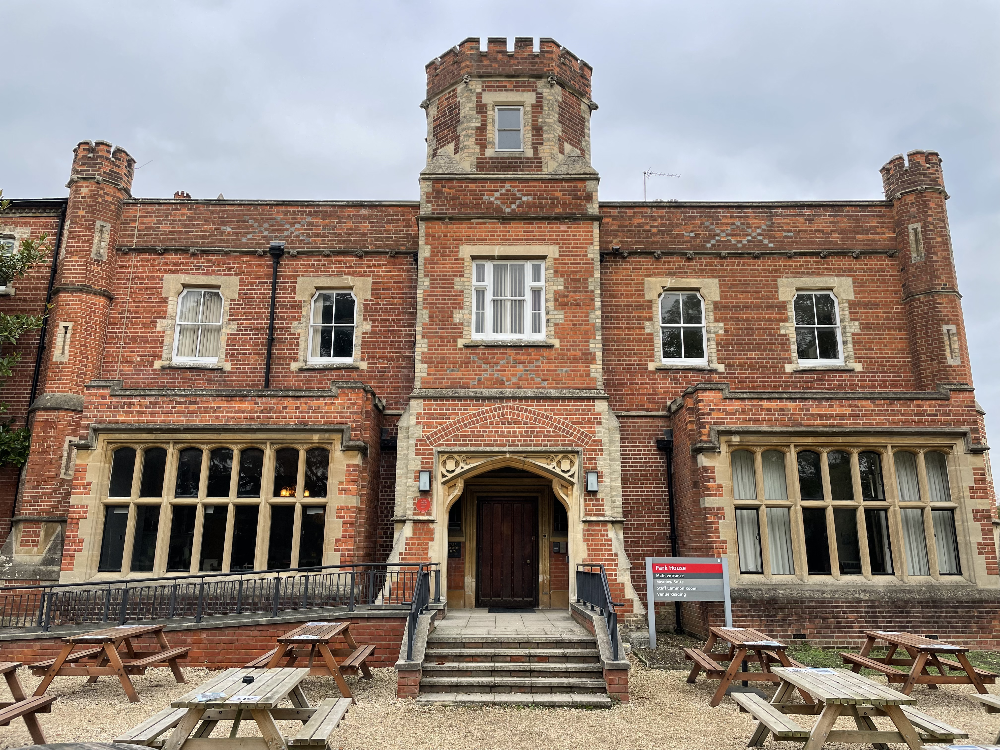

In [4]:
img = cv2.imread('/content/drive/MyDrive/Image Analysis/Group Coursework/images/IC_Assignment_Image1.bmp', 1)
cv2_imshow(img)

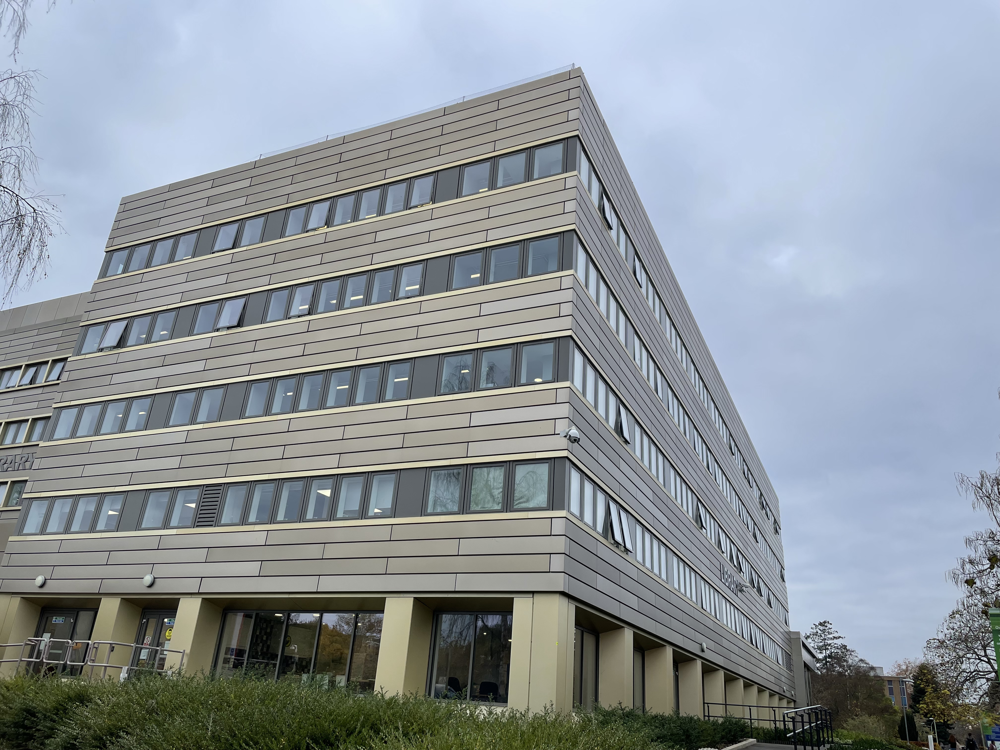

In [13]:
img2 = Image.open('/content/drive/MyDrive/Image Analysis/Group Coursework/images/IC_Assignment_Image2.bmp').convert('RGB')
display(img2)

In [8]:
import sys
from skimage import io
from sklearn.cluster import KMeans
import numpy as np

# reading filename

filename = sys.argv[1]

# reading the image
image = io.imread('/content/drive/MyDrive/Image Analysis/Group Coursework/images/IC_Assignment_Image2.bmp')
 
# preprocessing
rows, cols = image.shape[0], image.shape[1]
image = image.reshape(rows * cols, 3)

# modelling
print('Compressing...')
print('Note: This can take a while for a large image file.')
kMeans = KMeans(n_clusters = 16)
kMeans.fit(image)

# getting centers and labels
centers = np.asarray(kMeans.cluster_centers_, dtype=np.uint8)
labels = np.asarray(kMeans.labels_, dtype = np.uint8)
labels = np.reshape(labels, (rows, cols))
print('Almost done.')

# reconstructing the image
newImage = np.zeros((rows, cols, 3), dtype=np.uint8)
for i in range(rows):
    for j in range(cols):
            # assinging every pixel the rgb color of their label's center
            newImage[i, j, :] = centers[labels[i, j], :]
io.imsave('library.png'.split('.')[0] + '-compressed.png', newImage)

print('Image has been compressed sucessfully.')

Compressing...
Note: This can take a while for a large image file.
Almost done.
Image has been compressed sucessfully.


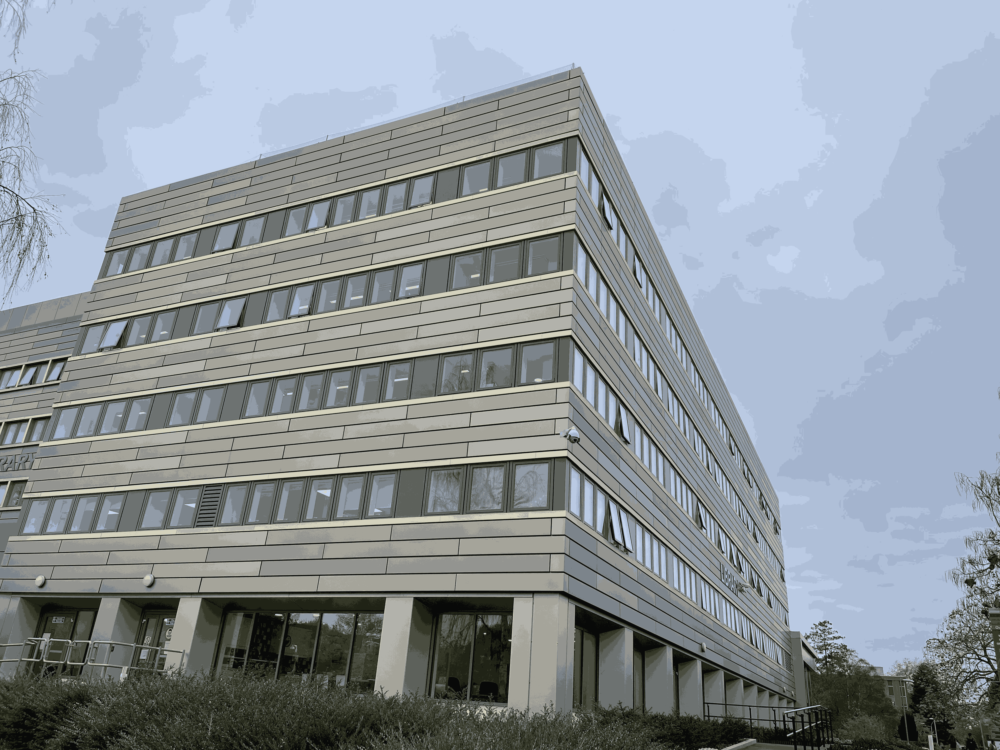

In [14]:
img2comp = Image.open('library-compressed.png').convert('RGB')
display(img2comp)

In [17]:
img2 = cv2.imread('/content/drive/MyDrive/Image Analysis/Group Coursework/images/IC_Assignment_Image2.bmp')

h, w, c = img2.shape

print('width:  ', w)
print('height: ', h)
print('channel:', c)

width:   4032
height:  3024
channel: 3


In [18]:
img2 = cv2.imread('/content/drive/MyDrive/Image Analysis/Group Coursework/images/IC_Assignment_Image2.bmp')

print(img2.size)

36578304


In [19]:
# CALCULATION AND DISPLAY OF COMPRESSION RATIO

mr = h
mc = w
singularValuesLimit = 160

originalSize = mr * mc * 3
compressedSize = singularValuesLimit * (1 + mr + mc) * 3

print('original size:')
print(originalSize)
print('\ncompressed size:')
print(compressedSize)
print('\nRatio compressed size / original size:')

ratio = compressedSize * 1.0 / originalSize

print(ratio)
print('\nCompressed image size is ' + str( round(ratio * 100 ,2)) + '% of the original image ' )
print('DONE - Compressed the image! ')

original size:
36578304

compressed size:
3387360

Ratio compressed size / original size:
0.09260571512555639

Compressed image size is 9.26% of the original image 
DONE - Compressed the image! 


In [20]:
dif = (np.subtract(img2, img2comp)) ** 2
mse = dif.mean()
mse

78.0509573379892

In [22]:
psnr = 10 * math.log10((1)**2/mse)
psnr

-18.923782342921736

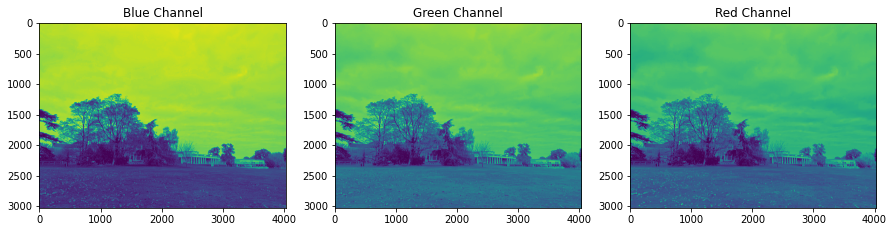

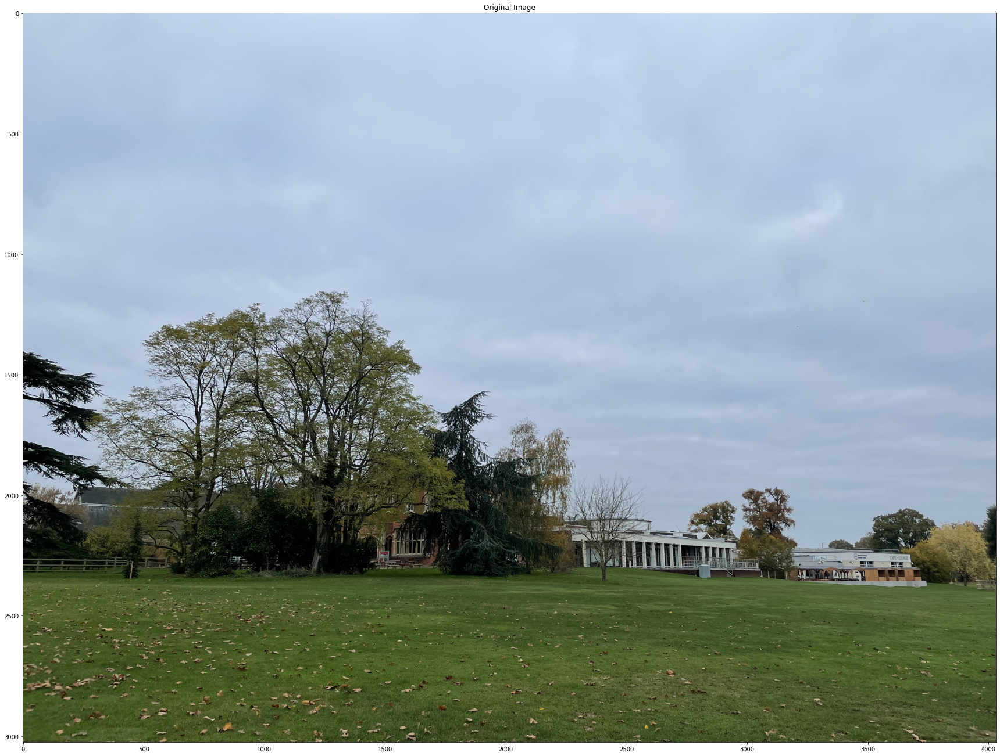

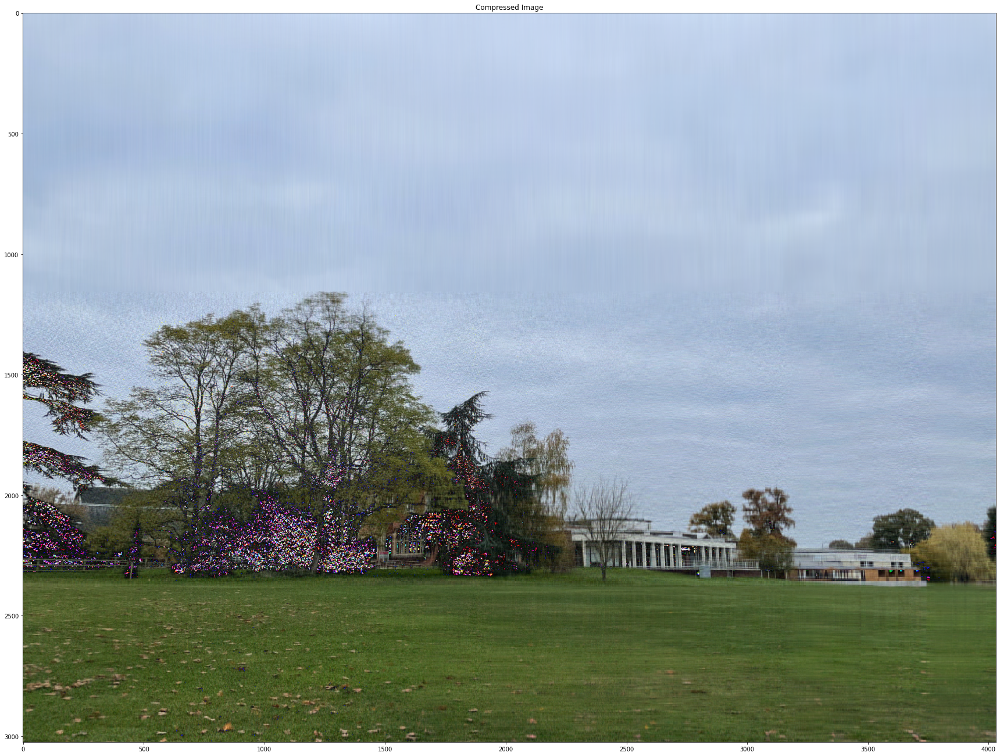

In [23]:
# Image is opened and 3 matrices are returned, with each matrix corresponding respectively to the Red, Green and Blue channels. Essentially, the color image is being split into RGB channels.
def accessImage(imagePath):
    img3og = Image.open(imagePath)
    img3chdiv = numpy.array(img3og)

    R = img3chdiv[:, :, 0]
    G = img3chdiv[:, :, 1]
    B = img3chdiv[:, :, 2]

    return [R, G, B, img3og]


# The matrices of the Red, Green and Blue channels obtained from accessImage are compressed seperately, using the Singular Value Decomposition method, and returned.
def compress(chDTAM, SVL):
    U, D, V = numpy.linalg.svd(chDTAM)
    chcmpr = numpy.zeros((chDTAM.shape[0], chDTAM.shape[1]))
    k = SVL

    LHS = numpy.matmul(U[:, 0:k], numpy.diag(D)[0:k, 0:k])
    chcmprin = numpy.matmul(LHS, V[0:k, :])
    chcmpr = chcmprin.astype('uint8')
    return chcmpr


# Image is called and sent to the accessImage function, along with the color variables.
R, G, B, oimg3 = accessImage('/content/drive/MyDrive/Image Analysis/Group Coursework/images/IC_Assignment_Image3.bmp')

# This is the singular values limit, which determines the number of singular values to use for reconstructing the compressed image.
SVL = 160

# The matrices for the Red, Green and Blue channels are displayed as plots to show the color distributions of the original image prior to compression.
fig = plt.figure(figsize = (15,15)) 
fig.add_subplot(131)
plt.title("Blue Channel")
plt.imshow(B)
fig.add_subplot(132)
plt.title("Green Channel")
plt.imshow(G)
fig.add_subplot(133)
plt.title("Red Channel")
plt.imshow(R)
plt.show()
print('\n')


RC = compress(R, SVL)
GC = compress(G, SVL)
BC = compress(B, SVL)

# The compressed channel matrices for R, G and B are obtained and are exported, creating the image memory needed for each channel. 
imgR = Image.fromarray(RC, mode=None)
imgG = Image.fromarray(GC, mode=None)
imgB = Image.fromarray(BC, mode=None)

# The compressed image is finally constructed by merging the image memory of the compressed channel matrices, R, G and B, together.
cimg3 = Image.merge("RGB", (imgR, imgG, imgB))

plt.figure(figsize = (30,30))
plt.title("Original Image")
plt.imshow(oimg3)
plt.show()

plt.figure(figsize = (30,30))
plt.title("Compressed Image")
plt.imshow(cimg3)
plt.show()

In [24]:
# The compression ratio for image 3 is calculated and displayed. The sizes are multiplied by 3 since we're dealing 
# with color images and the resulting values are in the form of bytes (divided by 1000000 to get MB).
# The calculations use the original image's height and width, as well as the compressed image's height and width.
oh = oimg3.height
ow = oimg3.width
cmprh = cimg3.height
cmprw = cimg3.width

ogSize = oh * ow * 3
cmprSize = SVL * (1 + cmprh + cmprw) * 3

print('Image 3 Original size: ' + str(ogSize) + ' bytes (' + str(round(ogSize/1000000, 2)) + ' MB)\n')

print('Image 3 Compressed size: ' + str(cmprSize) + ' bytes (' + str(round(cmprSize/1000000, 2)) + ' MB)\n')

rto = cmprSize / ogSize

print('Image 3 Compression ratio: ' + str(rto) + '\n')

print('Compressed image 3 size is ' + str(round(rto * 100, 2)) + '% of the original image 3.')

Image 3 Original size: 36578304 bytes (36.58 MB)

Image 3 Compressed size: 3387360 bytes (3.39 MB)

Image 3 Compression ratio: 0.09260571512555639

Compressed image 3 size is 9.26% of the original image 3.


In [25]:
# Final compressed image is saved to the directory.
cimg3.save('/content/drive/MyDrive/Image Analysis/Group Coursework/images/img3compressed.bmp')

In [26]:
# The Mean Square Error is calculated between the original image and the compressed image.
dif = (np.subtract(oimg3, cimg3)) ** 2
mse = dif.mean()
mse

38.40822573403075

In [27]:
# The Peak Signal to Noise Ratio is calculated using the MSE value obtained previously.
psnr = 10 * math.log10((1)**2/mse)
psnr

-15.84424245417781

As expected of the lossy compression technique, the Singular Value Decomposition compression technique caused irreversable data loss to the reconstructed image. This is proven by the calculated PSNR (Peak Signal to Noise Ratio) where the value returned is very low, confirming that the quality of the compressed-then-reconstructed image is lower than the original starting image. 

In [28]:
import cv2
import numpy as np

In [29]:
# Make array of brightest colour index
m = np.argmax(im, axis=2)

# Make empty results array same shape as original image
res = np.zeros_like(im)

# Where blue is the brightest, make result blue
res[m==0] = [255,0,0]

# Where green is the brightest, make result green
res[m==1] = [0,255,0]

# Where blue is the brightest, make result blue
res[m==2] = [0,0,255]  
cv2.imwrite('image.bmp',res)

True

In [30]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import cv2
from scipy.stats import stats
import matplotlib.image as mpimg

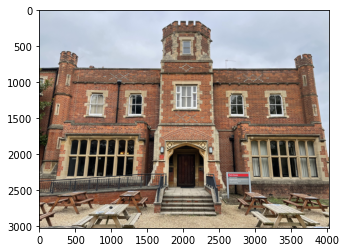

In [34]:
imgbg = cv2.cvtColor(cv2.imread('/content/drive/MyDrive/Image Analysis/Group Coursework/images/IC_Assignment_Image1.bmp'), cv2.COLOR_BGR2RGB)
plt.imshow(imgbg)
plt.show()

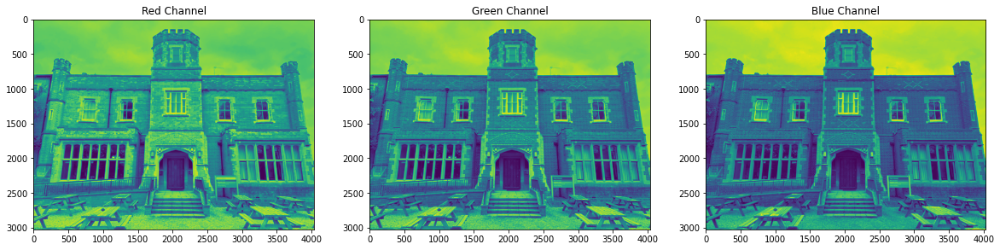

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


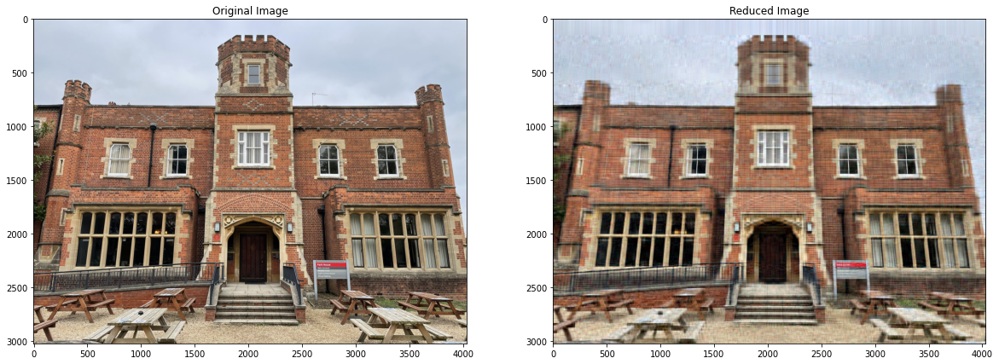

In [35]:
#https://towardsdatascience.com/dimensionality-reduction-of-a-color-photo-splitting-into-rgb-channels-using-pca-algorithm-in-python-ba01580a1118

#Splitting into the respective rgb channels
red,green,blue = cv2.split(imgbg)

#set the size of the figures
fig = plt.figure(figsize = (20, 9.5)) 

#Plot the image in each colour channel
#plot position on the console
fig.add_subplot(1,3,1)
plt.title("Red Channel")
plt.imshow(red)

fig.add_subplot(1,3,2)
plt.title("Green Channel")
plt.imshow(green)

fig.add_subplot(1,3,3)
plt.title("Blue Channel")
plt.imshow(blue)
#show figures
plt.show()

#make floating point number between 0-1
df_blue = blue/255
df_green = green/255
df_red = red/255

#reduce image from 485 dimensions to 50
pca_b = PCA(n_components=50)
pca_b.fit(df_blue)
trans_pca_b = pca_b.transform(df_blue)

pca_g = PCA(n_components=50)
pca_g.fit(df_green)
trans_pca_g = pca_g.transform(df_green)

pca_r = PCA(n_components=50)
pca_r.fit(df_red)
trans_pca_r = pca_r.transform(df_red)

#after dimensional reduction the channels must be inversed and then merged back together to recreate the image
b_arr = pca_b.inverse_transform(trans_pca_b)
g_arr = pca_g.inverse_transform(trans_pca_g)
r_arr = pca_r.inverse_transform(trans_pca_r)

img_reduced= (cv2.merge((r_arr, g_arr, b_arr)))

#figure size
fig = plt.figure(figsize = (20, 9.5)) 
#original image
fig.add_subplot(121)
plt.title("Original Image")
plt.imshow(imgbg)

#reduced image
fig.add_subplot(122)
plt.title("Reduced Image")
plt.imshow(img_reduced)

plt.show()


#width,height = imbg.size
#nwidth,nheight = img_reduced.size

#orsize = width*height*3
#nsize = nwidth*nheight*3

#print('Image 3 Original size: ' + str(ogSize) + ' bytes (' + str(round(ogSize/1000000, 2)) + ' MB)\n')

#print('Image 3 Compressed size: ' + str(cmprSize) + ' bytes (' + str(round(cmprSize/1000000, 2)) + ' MB)\n')

In [36]:
imgbg.size

36578304

In [37]:
img_reduced.size

36578304

In [38]:
dif = (np.subtract(img, img_reduced)) ** 2
mse1 = dif.mean()
mse1

22773.521947017714

In [39]:
mse = np.mean((img - img_reduced) ** 2)
mse

22773.521947017714

In [40]:
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt

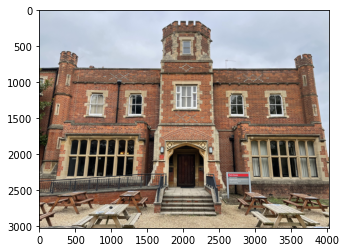

In [42]:
img = cv2.cvtColor(cv2.imread('/content/drive/MyDrive/Image Analysis/Group Coursework/images/IC_Assignment_Image1.bmp'), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()

In [43]:
inarray=np.array(img,dtype=np.float64)
orig=inarray

In [44]:
inarray.shape
(1569, 1456, 4)

(1569, 1456, 4)

In [45]:
inarray=inarray.reshape((-1,1))

In [46]:
inarray.shape
(9137856, 1)

(9137856, 1)

In [47]:
from sklearn.cluster import KMeans
kmeans=KMeans(n_clusters=4,init='random')

In [48]:
kmeans.fit(inarray)

KMeans(init='random', n_clusters=4)

In [49]:
centers=kmeans.cluster_centers_

In [50]:
labels=kmeans.labels_

In [51]:
array([3, 3, 3, 3, 3, 2], dtype=int32)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: scipy.array is deprecated and will be removed in SciPy 2.0.0, use numpy.array instead
  """Entry point for launching an IPython kernel.


array([3, 3, 3, 3, 3, 2], dtype=int32)

In [52]:
f=[]
centers=centers.squeeze()
for i in labels:
  f.append(centers[i])
final=np.asarray(f)

In [53]:
final=final.reshape(orig.shape)

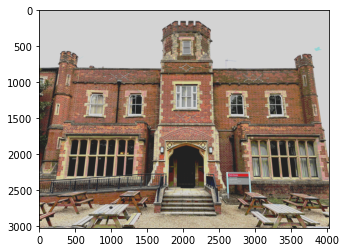

In [56]:
fycgxfinal=final/255
plt.imshow(fycgxfinal)
plt.show()